In [1]:
# Load file
import pickle
pkl_file = open('HORRIBLE_CELLFIT_DATA.pkl','rb')
cellfit_data = pickle.load(pkl_file)

In [2]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1,1,figsize = (14,10))

ax.set(xlim = [0,1000], ylim = [100,850], aspect = 1)

for i in range(len(cellfit_data['x'])):
    ax.plot(cellfit_data['x'][i], cellfit_data['y'][i], lw = 3)

    ax.plot(cellfit_data['x'][i][0], cellfit_data['y'][i][0], 'ok')
    ax.plot(cellfit_data['x'][i][-1], cellfit_data['y'][i][-1], 'ok')

plt.show()

<Figure size 1400x1000 with 1 Axes>

In [3]:
import sys
sys.path.insert(0, '../cell_soap/')
from cell_describe import node, edge, cell, colony, data, manual_tracing

ex = manual_tracing(cellfit_data['x'], cellfit_data['y'])
print('Number of edges:',len(cellfit_data['x']))

nodes, edges, new = ex.cleanup(10)

cells = ex.find_cycles(edges)


Number of edges: 207


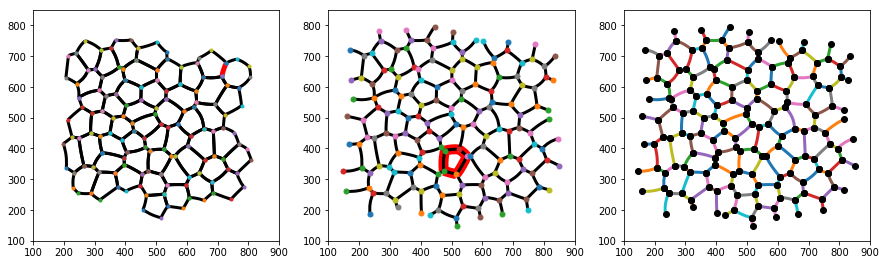

In [4]:
# Plot fitted edges

fig, (ax, ax1, ax2) = plt.subplots(1,3, figsize = (15,8))
ax.set(xlim = [100,900], ylim = [100,850], aspect = 1)
ax1.set(xlim = [100,900], ylim = [100,850], aspect = 1)
ax2.set(xlim = [100,900], ylim = [100,850], aspect = 1)
[c.plot(ax, lw = 3) for c in cells]
edges[100].cells[1].plot(ax1, lw = 10, color = 'red')

[n.plot(ax1, markersize = 10) for n in nodes]
[n.plot(ax1, markersize = 20) for n in nodes if len(n.edges) == 2]
[e.plot(ax1, lw = 3) for e in edges]
edges[180].plot(ax, color = 'red', lw = 5)

# [n.plot(ax2, markersize = 10) for n in nodes]
# [n.plot(ax2, markersize = 20) for n in nodes if len(n.edges) == 2]
# [e.plot(ax2, lw = 3) for e in edges]

for i in range(len(cellfit_data['x'])):
    ax2.plot(cellfit_data['x'][i], cellfit_data['y'][i], lw = 3)
    ax2.plot(cellfit_data['x'][i][0], cellfit_data['y'][i][0], 'ok')
    ax2.plot(cellfit_data['x'][i][-1], cellfit_data['y'][i][-1], 'ok')


plt.show()

In [5]:
# Calculate tension and pressure
import numpy.linalg as la
# Get unique cells
cells = ex.find_cycles(edges)

# Get tension and pressure
edges2 = [e for e in edges if e.radius is not None]
col1 = colony(cells, edges2, nodes)
tensions, P_T, A = col1.calculate_tension()

pressures, P_P, B = col1.calculate_pressure()

print('Number of edges:',len(col1.tot_edges))
print('Number of nodes:',len(col1.tot_nodes))
print('\n')

Initial Tension guess is [0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2,

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377


761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377


190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377


334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.6043021

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377


190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.6

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152


207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
2

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.81

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377


55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.213891664

370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.230261412

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.35747

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.7435974092326

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
85

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.476617

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.8878543600

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.374

182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.33245

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.780

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.52144063734

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.3809413

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448


51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.198

90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.450

359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.860048

268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.9500272541972

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.346277689450

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.171962683

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.335

96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.92731803

253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866


226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.898

769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.377954

180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.

226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
21

347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.5476203

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.836765736439

237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.682

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875

704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.258176908050

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942

112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.

410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.1

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.425651576

375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608

261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.5998397673

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.942906

997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127

147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.76593096154654

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.306

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548

312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.6773606678547

519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526

67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.885892370

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.3127888

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.6496357464

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.694

207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.037

856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.

378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.1388353681

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.433372

1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
3

593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161

284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.44339566

538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.0502

55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.7912604496

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
2

137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.604

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.3

183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6

187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.45053

144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664

68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121

429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664

181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.2651

103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.8576453896435

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.

238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.443

86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.52844

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226

185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.794303

85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.

167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387


3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.040943791

245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773


761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.980

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.5555

151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.509596648

66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.901504

334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789

85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.97448202

54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155

181.5284426412848 97.64016444372905
144.45919573680877 46.21802831109916
519.555556003342 448.4053641705076
182.41789131035497 110.12793453041634
185.78034816274823 98.69125821750652
538.6040487833023 450.73833731316415
359.3065027675142 278.4942327001346
55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.870907051

55.26515657245218 141.79396628131002
769.8985607330242 700.1244904397902
(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.5016

(122, 50) (122,)
168.20393198529342 80.9429069076675
280.96438475566 182.9744820250115
714.0672260017393 652.2138916640915
45.22707141664241 109.65431533875304
997.0311272194785 1056.00990155811
85.615496562737 184.85764538964355
1338.6128365103755 1271.3462776894503
312.7990976827827 403.1876725429152
229.37686983153213 314.95002725419727
344.72408453620477 427.5214406373461
387.1317017067923 320.25817690805036
147.89672528292752 69.59983976732647
205.9473090582441 119.79126044965176
190.38008961146681 116.17196268301812
131.89809927986704 52.04094379108102
180.4462887305731 111.64963574647285
218.32205075506448 139.50959664861173
1696.14226972822 1768.8709070517039
136.23018645019647 192.88983664929478
250.82617602403923 318.3508526757704
199.41756364496376 276.3324571753115
243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093

52.69444489966637 47.0638465003191
120.37411249787885 210.685188791854
334.4505311599381 272.8078352771329
179.60430211452746 100.5700839403019
137.54762039297478 55.73033538340045
162.9273180329516 80.85674960468413
181.96745608231763 256.8540818855478
151.2566161299938 220.82068429024255
67.38094133913211 139.91760622343878
551.4333726184732 630.3599284127669
85.42565157605259 192.21600892865243
140.23026141206265 230.38195763017973
312.4433956660815 231.424052363676
54.88785436005727 121.61437299965712
103.13883536817967 183.80277081405526
197.98490179000962 108.95777648776514
153.31278886597573 70.7007737118511
333.568121533536 240.59911779609962
139.37795468692224 57.86245516665087
704.4766171629284 776.077953694058
261.88589237010126 334.4931310018096
55.81357942840826 144.38146501506623
400.9015048991652 485.60592186045125
3910.0836305317266 3982.2327454201445
247.3574705100998 159.26709183419345
151.40664468143277 58.34261233893049
181.5284426412848 97.64016444372905
144.459195

243.44243496734623 307.79430320476905
27855.61622315492 27930.05020756745
410.78529890646365 500.86004879737055
237.34988411215343 164.50161088882112
90.9997387491887 183.30548529993172
723.6383225674758 654.5093833954735
253.69427952843935 332.2579399120923
210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13

210.8103391426963 280.3628476241474
740.4723840998232 671.8622025117994
124.90307130231304 192.50332228840054
127.31259569343247 195.81910948289377
2450.807965158247 2538.8367657364392
238.19604710443667 172.67736066785477
192.36414949885676 126.30965299791836
51.67833974454875 50.74359740923267
149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2

149.23696044034824 68.7351252921709
112.02444964442456 45.765930961546545
186.7026567844799 95.59449143526936
183.78544749466047 99.7282546599448
180.40755252511133 86.76538254060638
347.7782439232642 418.8421024423342
856.8399805990351 939.5940247409985
226.26369872553198 159.0142448364012
498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.0

498.86477321399366 431.9570729997095
146.7555136442644 227.554234858835
167.66470665603032 108.38207755942426
992.6335978413852 902.3073693879985
245.13759769588856 175.15467466326027
242.67362124169745 330.46019593013284
688.5355627861129 625.9081743004976
85.68223596695547 159.14314453038168
118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
3

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

118.45044892608745 191.28536976682298
207.5357253894824 277.2256307394949
90.77779306756291 154.85723196098937
761.2644079049977 841.4679027382261
1057.950458382788 1134.0555989517275
384.54506869593484 306.3710848362286
268.30774780721487 176.6858168880826
96.33598839249623 158.17163278618582
67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.

67.44300293632426 135.14509367571864
244.03779422396588 191.42662861825124
187.19878353402913 113.62825139668138
180.07016704084836 88.38311022442072
217.08229884879054 139.59387946510753
570.2732158134388 641.9272174602482
375.9907409090335 300.2065965526852
593.6584488232629 508.0428918338957
21678.58056124707 21598.890676440762
195.34456885674751 250.34256018631717
217.27287509290363 138.88741373338527
370.3820118281092 296.75751256087545
284.4266469484902 207.2776435731387
1671.2044492283328 1577.6019242676866
378.3764743580041 309.0109915212773
93.22508938518078 161.48276076882576
256.2691802821625 321.224704907904
68.18051603719891 150.0962064119578
180.55679236708008 93.17162394413566
239.72306591045339 308.21592193786006
639.6549343761176 563.127081557232
307.6074047530186 395.6911460316498
66.9805339500865 159.20255212275208
200.25964183909784 276.95698973247465
152.64662790044906 228.5551138362516
429.1320428784201 506.58249168461623
86.95441358116396 165.92950889624424
52.69

In [8]:
import numpy as np
np.mean(pressures)

0.005799448707903399

In [12]:
tension_solution = {'edges': [], 'tension': []}
for e in edges:
    tension_solution['edges'].append(e)
    tension_solution['tension'].append(e.tension)
    
pressure_solution = {'cells': [], 'pressure': []}
for e in cells:
    pressure_solution['cells'].append(e)
    pressure_solution['pressure'].append(e.pressure)

In [15]:
# # Save file
# import pickle
# # Saving the objects:
# with open('HORRIBLE_CELLFIT_DATA_sol_pressure_v2.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
#     pickle.dump(pressure_solution, f)

In [4]:
# Load file
import pickle
pkl_file = open('HORRIBLE_CELLFIT_DATA_sol_tension_v2.pkl','rb')
edge_dict = pickle.load(pkl_file)
tensions = edge_dict['tension']

In [5]:
import pickle
pkl_file = open('HORRIBLE_CELLFIT_DATA_sol_colony_v2.pkl','rb')
col1 = pickle.load(pkl_file)

In [6]:
# Load file
import pickle
pkl_file = open('HORRIBLE_CELLFIT_DATA_sol_pressure_v2.pkl','rb')
edge_dict = pickle.load(pkl_file)
pressures = edge_dict['pressure']

[(100, 850), (100, 900), None]

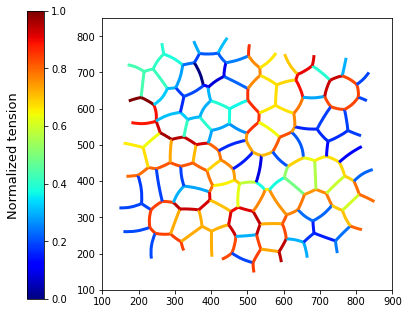

In [9]:
# Plot 
import pylab
import matplotlib.pyplot as plt
from matplotlib import cm
fig, ax = plt.subplots(1,1,figsize=(8,5))
col1.plot_tensions(ax, fig, tensions, lw = 3)
ax.set(xlim = [100,900], ylim = [100,850], aspect = 1)

[(100, 850), (100, 900), None]

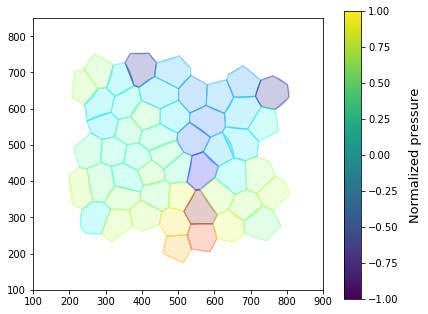

In [10]:
# Plot 
import pylab
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1,1,figsize=(8,5))
col1.plot_pressures(ax, fig, pressures, lw = 3)
ax.set(xlim = [100,900], ylim = [100,850], aspect = 1)

[(100, 850), (100, 900), None]

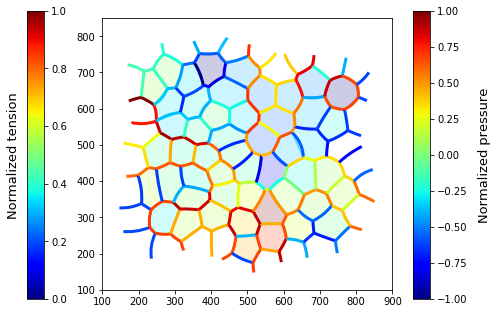

In [11]:
# Plot 
import pylab
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1,1,figsize=(8,5))
col1.plot(ax, fig,tensions, pressures, lw = 3)
ax.set(xlim = [100,900], ylim = [100,850], aspect = 1)

In [10]:
col1

In [7]:
edges[10].cells